In [3]:
import wandb
from train import ConvNN
from pathlib import Path

checkpoint_reference = "livinNector-academic/inat-scratch-conv/model-lcgfndjw:best"
run = wandb.init(project="inat-scratch-conv")
artifact = run.use_artifact(checkpoint_reference, type="model")
artifact_dir = artifact.download()
model = ConvNN.load_from_checkpoint(Path(artifact_dir) / "model.ckpt")

wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: livinnector (livinNector-academic) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


wandb:   1 of 1 files downloaded.  


In [4]:
from trainer import InaturalistDataModule
datamodule = InaturalistDataModule('inaturalist_12K')

In [5]:
import pytorch_lightning as pl
pl.Trainer().test(model,datamodule=datamodule)


INFO:pytorch_lightning.utilities.rank_zero:You are using the plain ModelCheckpoint callback. Consider using LitModelCheckpoint which with seamless uploading to Model registry.
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│       test_accuracy       │    0.3059999942779541     │
│       test_f1_score       │    0.29473981261253357    │
│         test_loss         │     1.958498239517212     │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': 1.958498239517212,
  'test_accuracy': 0.3059999942779541,
  'test_f1_score': 0.29473981261253357}]

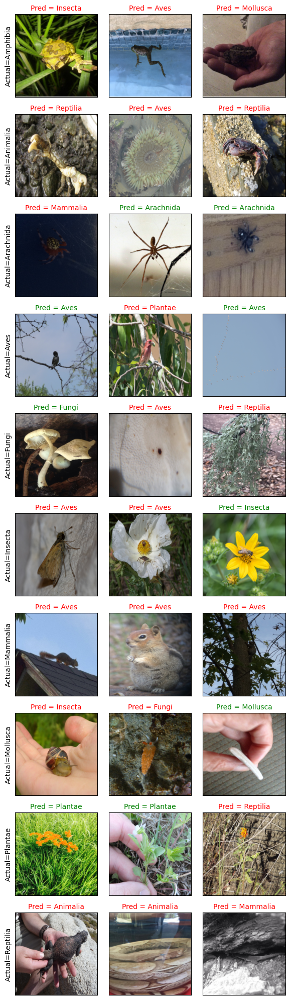

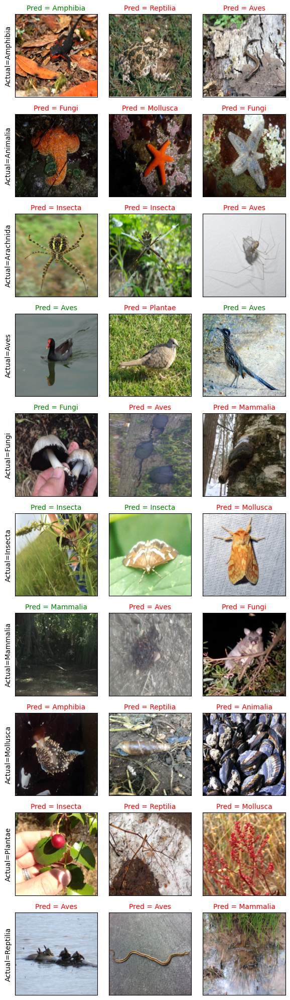

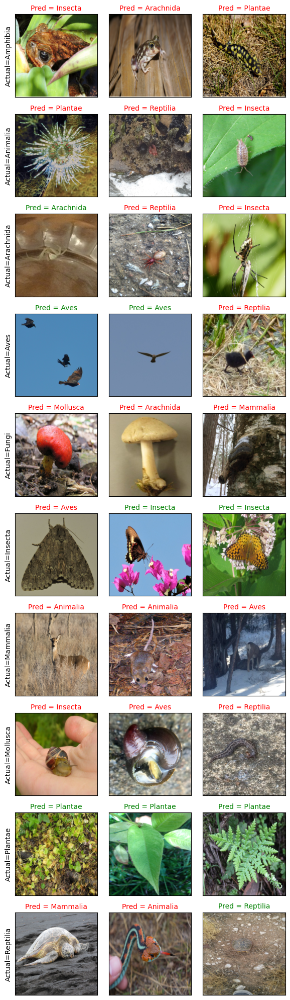

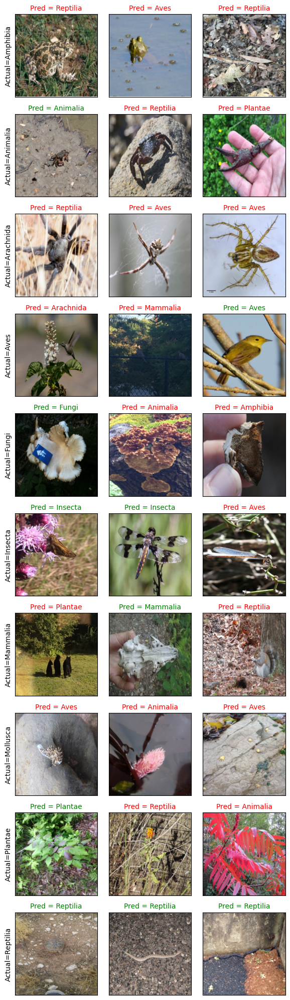

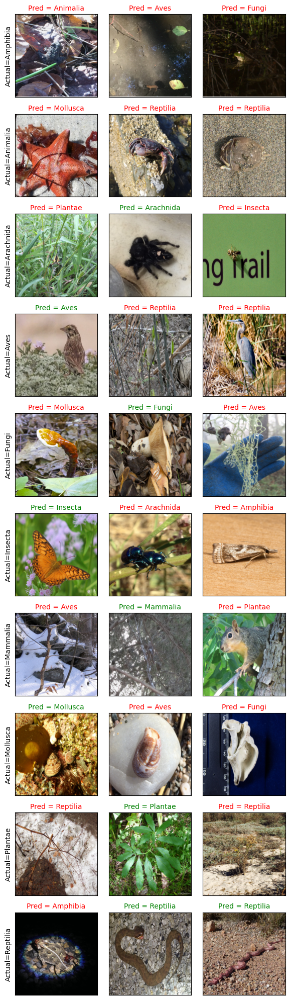

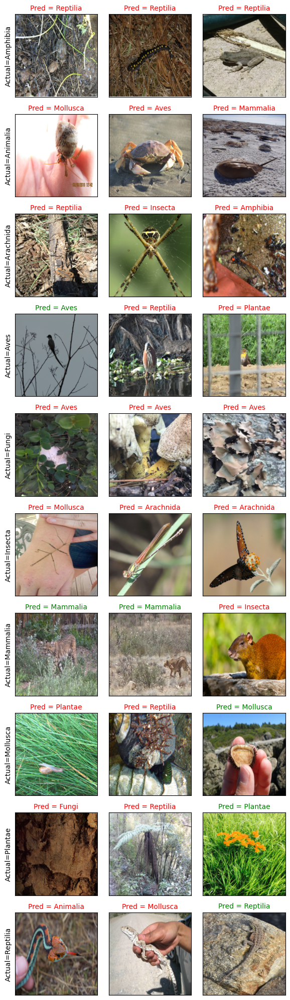

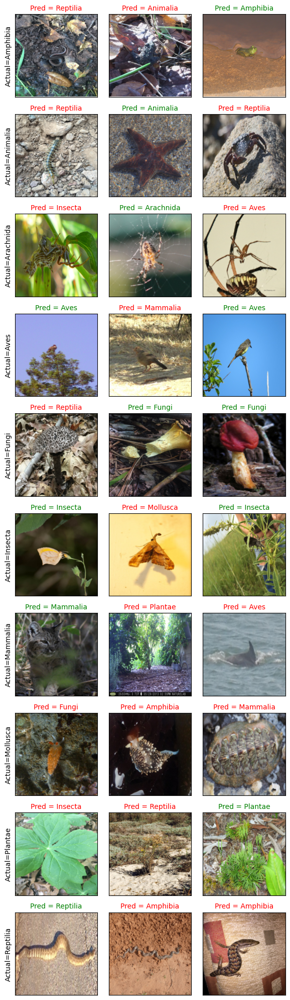

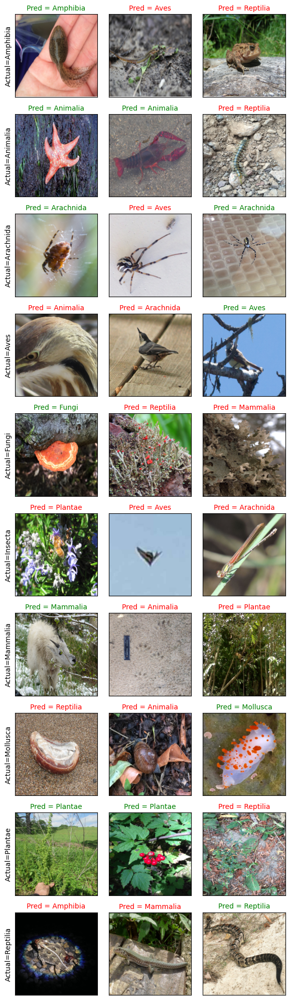

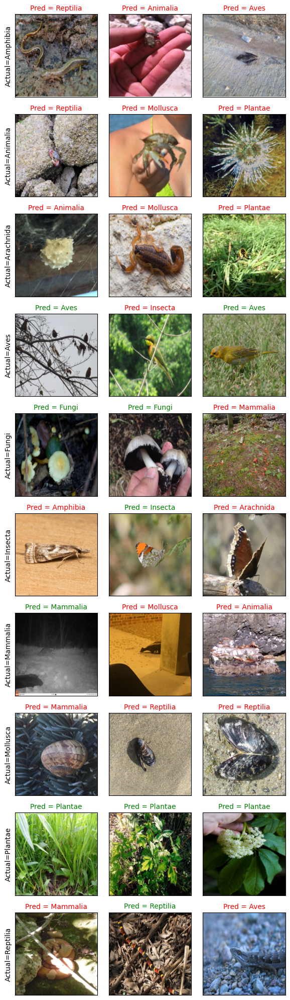

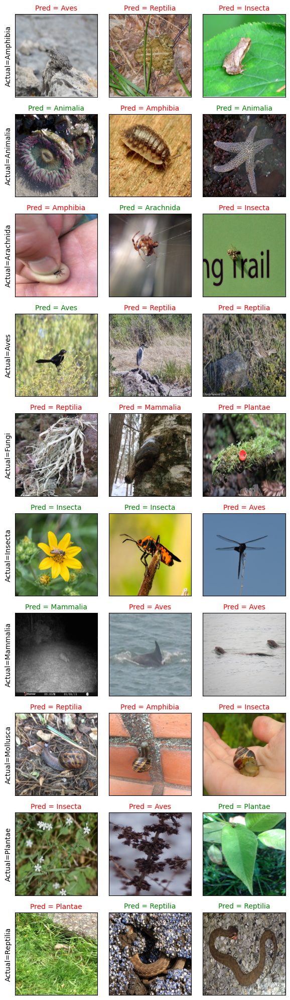

In [6]:
import matplotlib.pyplot as plt
import numpy as np
import torch
import pandas as pd
from torch.utils.data import Subset, DataLoader


def plot_sample_predictions_per_class(model, datamodule, class_names=None, seed=1):
    device="cuda" if torch.cuda.is_available() else "cpu"
    model.eval().to(device)


    samples = pd.Series([label for _, label in datamodule.test_dataset.samples])
    samples = samples.groupby(samples).sample(3,random_state=seed).agg(lambda x: list(x.index))

    dataset = Subset(datamodule.test_dataset, samples)
    data_loader = DataLoader(dataset, batch_size=1)
    num_classes = len(class_names)

    fig, axs = plt.subplots(num_classes, 3, figsize=(3*2,num_classes * 2))

    with torch.no_grad():
        for i, (x, y) in enumerate(data_loader):
            x, y = x.to(device), y.to(device)
            label = y[0].item()
            logits = model(x)
            pred = logits.argmax(dim=1)[0].item()

            img_np = x[0].permute(1, 2, 0).to('cpu').numpy()
            r,c = i//3,i%3
            axs[r][c].imshow(img_np)
            axs[r][c].set_xticks([])
            axs[r][c].set_yticks([])

            title = f"Pred = {class_names[pred]}"
            axs[r][c].set_title(title, fontsize=10,color='red' if label!=pred else 'green')

    for i in range(num_classes):
        plt.setp(axs[i,0], ylabel=f"Actual={class_names[i]}")
    plt.tight_layout()
    plt.show()
    return fig

for i in range(10):
    wandb.log({"sample_predictions": wandb.Image(plot_sample_predictions_per_class(model, datamodule, class_names = datamodule.train_dataset.classes,seed=i))})
wandb.finish()